<a href="https://colab.research.google.com/github/Shashwat26Bhatnagar/Myprofile/blob/main/plotl.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [30]:
!pip install chart_studio
!pip install jupyter-dash
!pip install plotly

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


IMPORT

In [32]:
import pandas as pd
import numpy as np
import cufflinks as cf
import chart_studio.plotly as py
import seaborn as sns
import plotly.express as px
%matplotlib inline
from jupyter_dash import JupyterDash
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
init_notebook_mode(connected=True)
cf.go_offline()

def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)


Basics

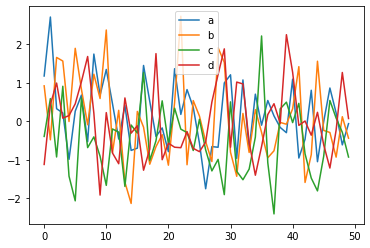

In [33]:
import pandas as pd
import numpy as np
import cufflinks as cf
import chart_studio.plotly as py
import seaborn as sns
%matplotlib inline
import plotly.express as px
from jupyter_dash import JupyterDash
import plotly.offline as py_offline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.io as pio
pio.renderers.default = 'colab'
from plotly.offline import init_notebook_mode, iplot
cf.go_offline()
import dash_html_components as html

arr_1=np.random.randn(50,4)#50- number of data and 4 is column number\
df_1=pd.DataFrame(arr_1,columns=['a','b','c','d'])
df_1.head()
df_1.plot()
enable_plotly_in_cell()
df_1.iplot()

Line plots


In [63]:
import plotly.graph_objects as go
enable_plotly_in_cell()

df_stocks=px.data.stocks()#ploty xpress take real time data from various fields such as stocks in this case
px.line(df_stocks,x="date",y="GOOG",labels={'x':'Data','y':'Price'})
px.line(df_stocks,x='date',y=['GOOG',"AAPL"],labels={'x':'Date','y':'Price'},title="Apple vs Google")

fig=go.Figure()
fig.add_trace(go.Scatter(x=df_stocks.date,y=df_stocks.AAPL,mode='lines',name='Apple'))
fig.add_trace(go.Scatter(x=df_stocks.date,y=df_stocks.AMZN,mode='lines+markers',name='Amazon'))
fig.add_trace(go.Scatter(x=df_stocks.date,y=df_stocks.AMZN,mode='lines+markers',name='google',line=dict(color='firebrick',width=2,dash='dashdot')))
# fig.update_layout(title="stock pricce data",xaxis_title="price",yaxis_title="date")
fig.update_layout(
    xaxis=dict(showline=True,showgrid=False,showticklabels=True,linecolor='rgb(204,204,204)',linewidth=2,ticks='outside',tickfont=dict(family='Arial',size=12,color='rgb(82,82,82)')),
    yaxis=dict(showgrid=False,zeroline=True,showline=False,showticklabels=False),
    autosize=False,
    margin=dict(autoexpand=False,l=100,r=20,t=11),
    showlegend=False,plot_bgcolor='white'
)


Bar Charts

In [87]:
enable_plotly_in_cell()
df_us=px.data.gapminder().query("country=='United States'")
px.bar(df_us,x='year',y='pop',labels={'year':'Time','pop':'Population in million'})
df_tips=px.data.tips()
px.bar(df_tips,x='day',y='tip',color='sex',title='Tips by sex on each day',labels={'tip':'Tip Amount','day':'Day of weeks'})
px.bar(df_tips,x='sex',y='total_bill',color='smoker',barmode='group')#barcode will segregate the groups according to the colour provide for clear understanding of data other wise the colour would have been clustered in the same bar graph 


df_europe=px.data.gapminder().query("continent=='Europe' and year ==2007 and pop>2.e6")
fig=px.bar(df_europe,y='gdpPercap',x='country',text='pop',color='country')
fig.update_traces(texttemplate='%{text:.2s}',textposition='outside')
fig.update_layout(xaxis_tickangle=-45)
fig

Scatters plots

In [100]:
enable_plotly_in_cell()
df_iris=px.data.iris()#IRIS IS ABOUT PETALS
px.scatter(df_iris,x='sepal_width',y='sepal_length',color='species',size='petal_length',hover_data=['petal_width'])
fig=go.Figure()
fig.add_trace(go.Scatter(x=df_iris.sepal_width,y=df_iris.sepal_width,mode='markers',marker_color=df_iris.sepal_width,text=df_iris.species,marker=dict(showscale=True)))
fig.update_traces(marker_line_width=2,marker_size=10)

##When you are working with bigger data
fig=go.Figure(data=go.Scattergl(x=np.random.randn(100000),y=np.random.randn(100000),mode='markers',marker=dict(color=np.random.randn(100000),colorscale='viridis',line_width=1)))
fig

ANimated


In [108]:
enable_plotly_in_cell()
df_cnt=px.data.gapminder()
px.scatter(df_cnt,x='gdpPercap',y='lifeExp',animation_frame="year",animation_group="country",size="pop",color='continent',hover_name="country",log_x=True,size_max=55,range_x=[100,100000],range_y=[25,90])#jab group jayda hi chota ho tho visiblity k liye size max ko 55 kardena
#in case of change in one axis with respect to time is way higher then other then for make data reable apply log_x or log_y accordingly